## Experiment: 0.5fake-Dmask-noADA
purpose: To find out why training broken. (potential cause: distribution of face position & its correlation to face)
[report](https://wandb.ai/jimmya/stylegan2-face2fullbody-ada/reports/20210714-add-Mask-to-Discriminator--Vmlldzo4NTAxMDQ)

* real_face real_mask (train/val)
* fake_face fake_mask
* fake_face real_mask (random/phi)

In [1]:
import json
import torch
import pickle
import numpy as np
from PIL import Image
from torchvision.utils import make_grid
from IPython.display import display

from config import get_cfg_defaults
from models import Discriminator, Generator
from dataset import get_dataset, get_dataloader
from augment import AugmentPipe
from run_training import mixing_noise

Setting up PyTorch plugin "fused"... Done.


In [2]:
def show(imgs):
    grid = make_grid(
        imgs,
        nrows=4,
        normalize=True,
        value_range=(-1,1)
    )
    if grid.device.type == 'cuda':
        grid = grid.cpu()
    
    if grid.shape[0] == 3:
        display(Image.fromarray((np.clip(grid.numpy().transpose(1,2,0) * 255, 0, 255).astype(np.uint8))))
    elif grid.shape[0] == 1:
        display(Image.fromarray(np.clip(grid.numpy()[0].transpose(1,0) * 255, 0, 255).astype(np.uint8), mode='L'))
    else:
        print("unknown #ch:", imgs.shape)

In [3]:
cfg = get_cfg_defaults()
cfg.merge_from_file('experiments/face2fullbody-ada.yml')

In [4]:
ckpt = torch.load('/home/yct/experiments/00010-emdzyc3r-4gpu-0.5fake-Dmask-noADA/checkpoints/ckpt-050000.pt')
g = Generator(
    512,
    cfg.num_classes,
    cfg.resolution,
    extra_channels=cfg.MODEL.extra_channel,
    use_style_encoder=cfg.MODEL.use_style_encoder,
    map_kwargs=cfg.MODEL.G_MAP,
    style_encoder_kwargs=cfg.MODEL.STYLE_ENCODER,
    synthesis_kwargs=cfg.MODEL.G_SYNTHESIS,
).cuda().eval()
g.load_state_dict(ckpt['g_ema'])

d = Discriminator(
    cfg.num_classes,
    cfg.resolution,
    extra_channels=1
).cuda().eval()

d.load_state_dict(ckpt['d'])

<All keys matched successfully>

In [3]:
if globals().get('d_output') is None:
    d_output = pickle.load(open('d_output.pkl', 'rb'))

In [6]:
# real_face, face_position: [real, resample], body_info(apply mask to RGB), mask_is_matched

# Dataset
real_ds = get_dataset(cfg.DATASET, split='train')
real_ds_gt = get_dataset(cfg.DATASET, split='train', resampling='gt')
real_ds_pred = get_dataset(cfg.DATASET, split='train', resampling='pred')

In [17]:
def get_D_output(ds, feed_G=False, D_input_mask_body=False, show_n=1):
    d_out = []
    print("dataset size:", len(ds))
    loader = torch.utils.data.DataLoader(ds, batch_size=8, num_workers=12, worker_init_fn=ds.__class__.worker_init_fn)
    for i, batch in enumerate(loader):
        if i == 0:
            print("data example")
            for data in batch:
                show(data)

        body, face, mask, *args = [x.cuda() for x in batch]
        bs = body.shape[0]
        if len(args) == 1:
            # real dataset, resampling face position
            if not feed_G:
                assert D_input_mask_body is True, "There is no ground truth body When resampling face position and without Generator"
            masked_body = args[0]
            d_input = masked_body
        else:
            masked_body = body * mask
            d_input = body

        if feed_G:
            if i < show_n:
                print("Generator Content input(RGB part)")
                show(masked_body)
            noise = mixing_noise(bs, g.z_dim, 0.9, 'cuda')
            fake_img, _ = g(noise, style_in=face, content_in=torch.cat([masked_body, mask], dim=1), noise_mode='const')
            d_input = fake_img

        if D_input_mask_body:
            d_input = d_input * mask
        
        if i == 0:
            print("Discriminator input")
            show(d_input)

        d_input = torch.cat([d_input, mask], dim=1)
        d_out.append(d(d_input).detach().cpu().numpy())
        print(f"{i}", end='\r')
    print()
    return np.concatenate(d_out, axis=0)

In [ ]:
# 以下都是形容 Discriminator 的 input，都為 4 個 channel, 第四個 channel 是 mask

dataset size: 22202
data example


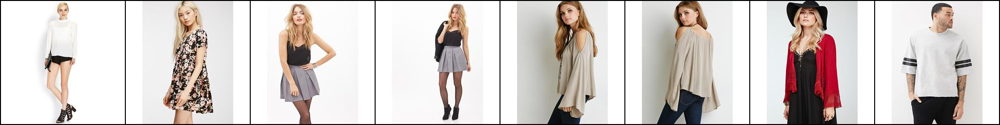

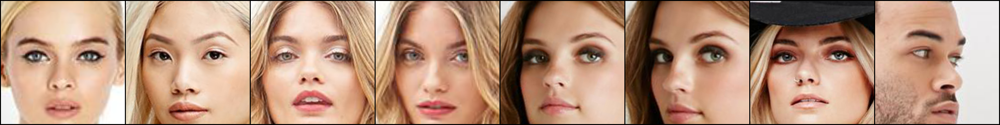

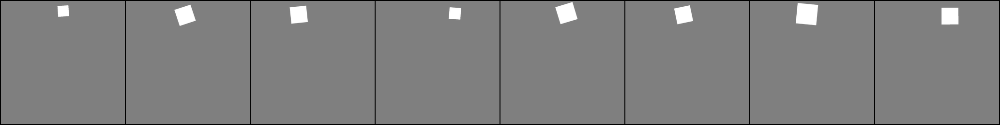

Discriminator input


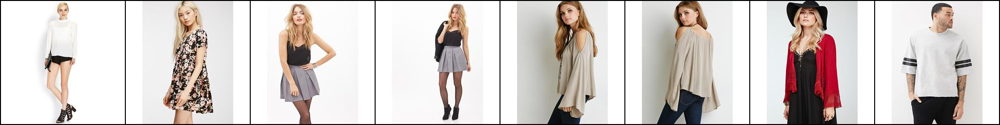

2775


In [9]:
# 原圖
out1 = get_D_output(real_ds, feed_G=False, D_input_mask_body=False)

dataset size: 22202
data example


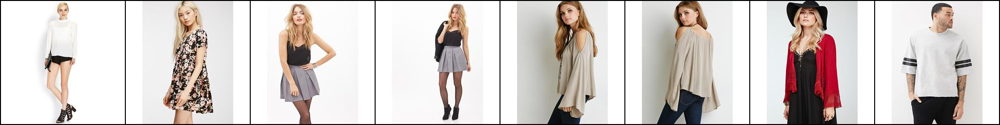

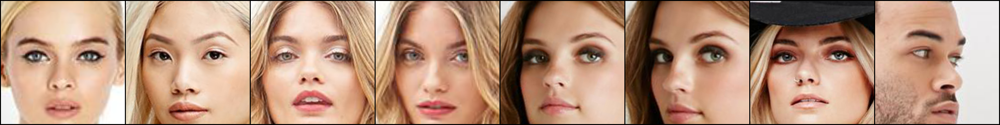

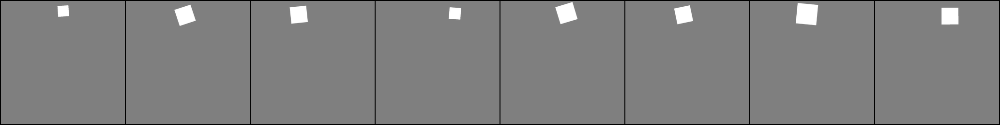

Discriminator input


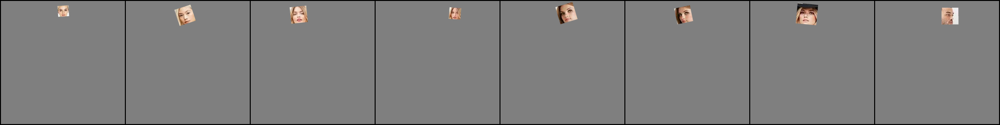

2775


In [10]:
# 原圖mask掉身體
out2 = get_D_output(real_ds, feed_G=False, D_input_mask_body=True)

dataset size: 22202
data example


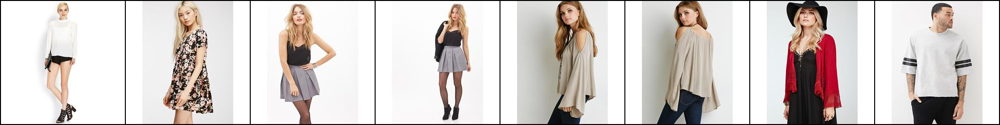

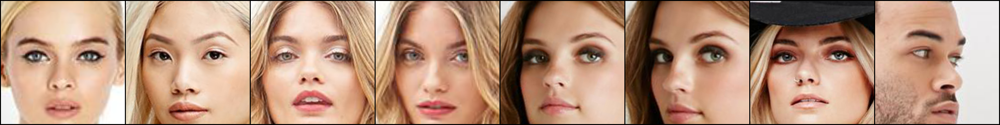

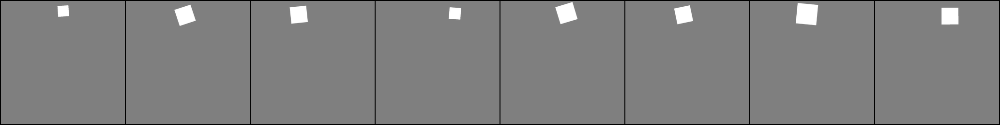

Generator Content input(RGB part)


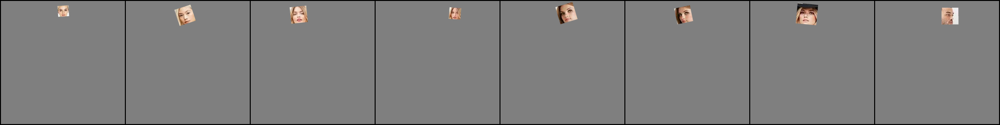

Discriminator input


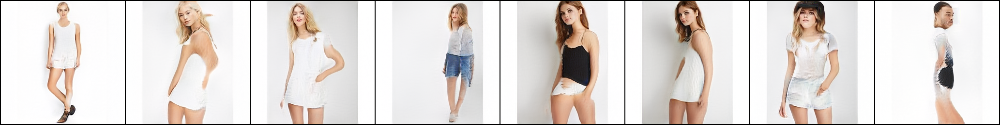

2775


In [21]:
# 原圖mask掉身體 + mask -> Generator -> 的輸出
out3 = get_D_output(real_ds, feed_G=True, D_input_mask_body=False)

dataset size: 22202
data example


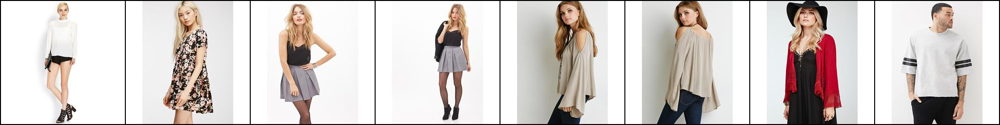

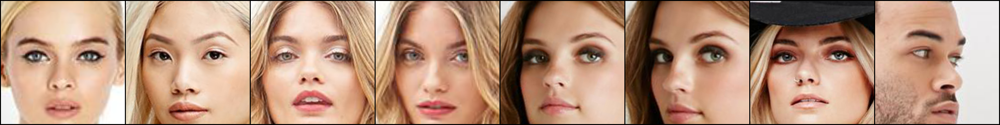

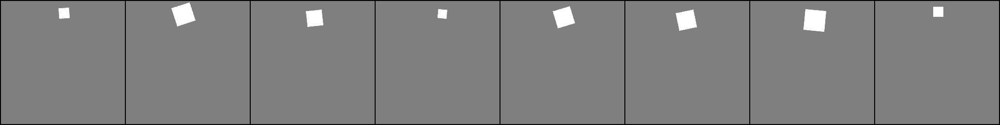

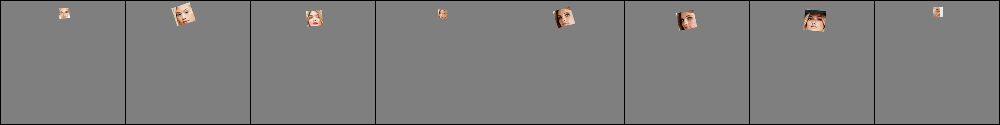

Discriminator input


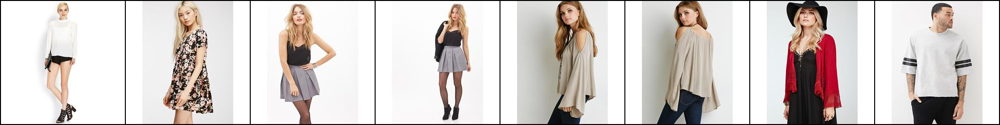

Setting up PyTorch plugin "upfirdn2d_plugin"... Done.
2775


In [8]:
# 原圖 + resample 過後的 mask（角度一樣，大小和位置不同）
out4 = get_D_output(real_ds_gt, feed_G=False, D_input_mask_body=False)

dataset size: 22202
data example


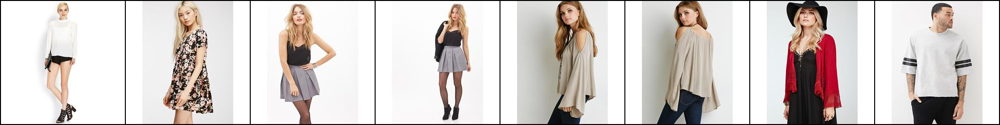

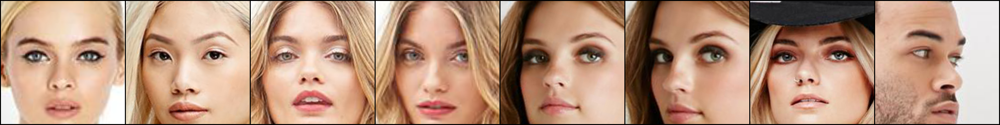

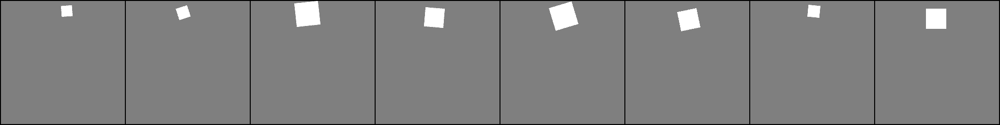

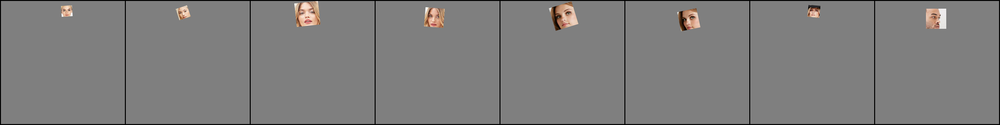

Discriminator input


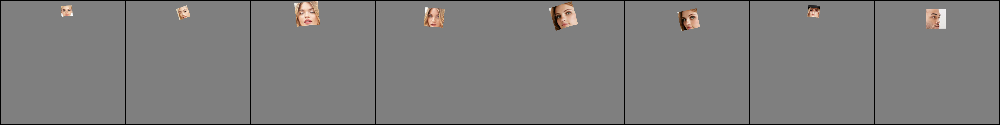

2775


In [16]:
# resample 過後的臉與mask (所以沒有身體)
out5 = get_D_output(real_ds_gt, feed_G=False, D_input_mask_body=True)

dataset size: 22202
data example


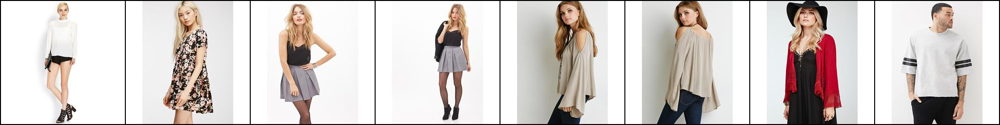

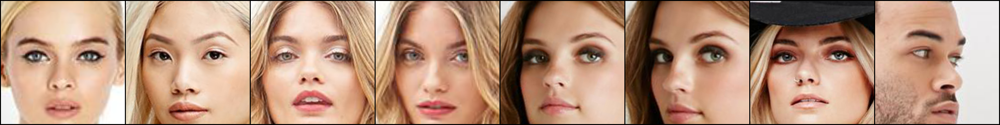

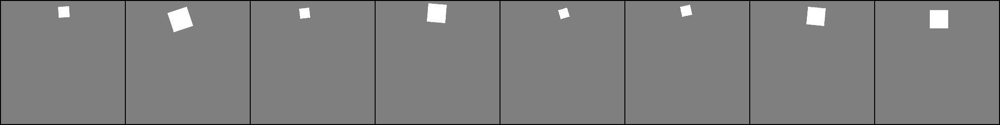

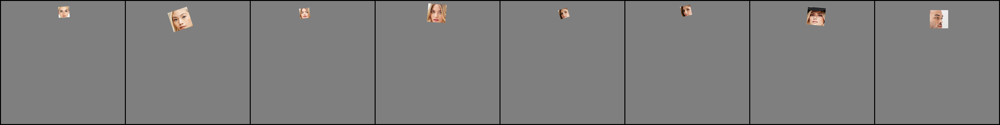

Generator Content input(RGB part)


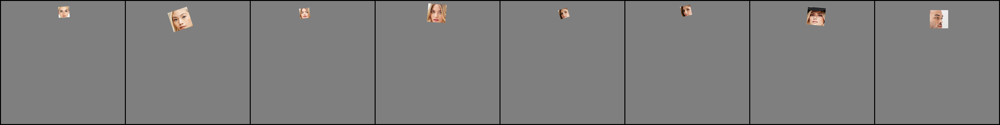

Discriminator input


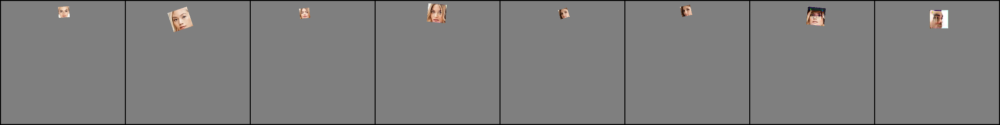

2775


In [18]:
# resample 過後的臉與mask -> 經過 Generator 生出的圖片 -> mask 掉身體 (應該要和5幾乎一樣)
out5_2 = get_D_output(real_ds_gt, feed_G=True, D_input_mask_body=True)

dataset size: 22202
data example


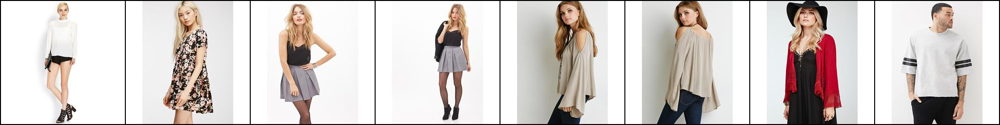

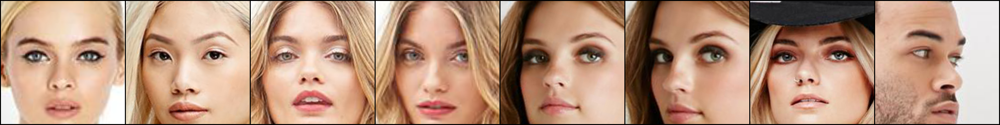

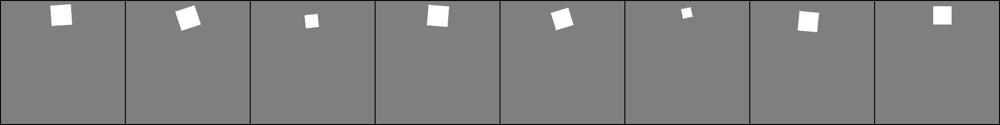

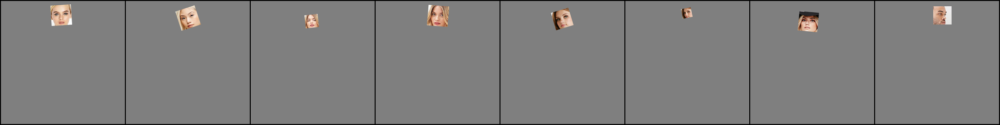

Generator Content input(RGB part)


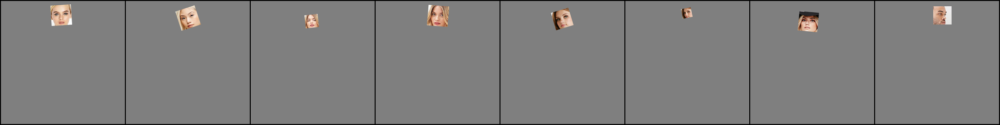

Discriminator input


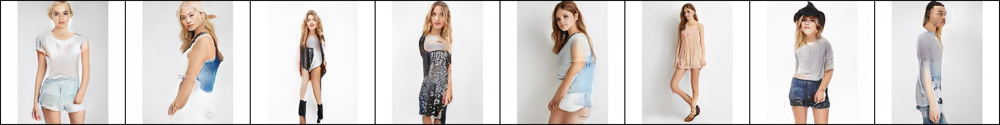

2775


In [10]:
# resample 過後的臉與mask -> 經過 Generator 生出的圖片
out6 = get_D_output(real_ds_gt, feed_G=True, D_input_mask_body=False)

dataset size: 22202
data example


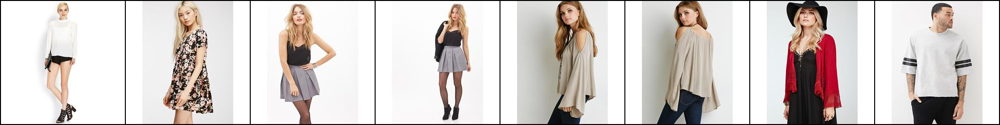

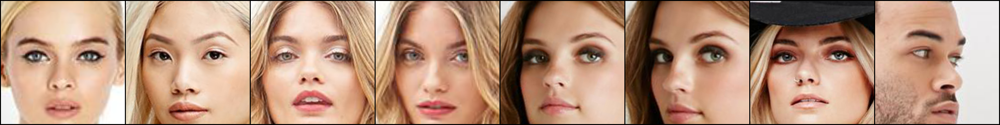

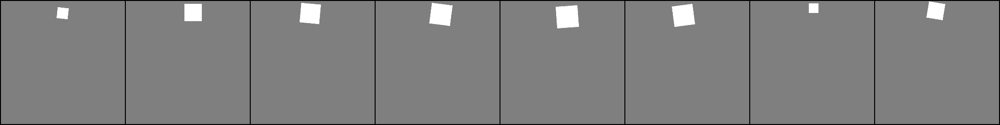

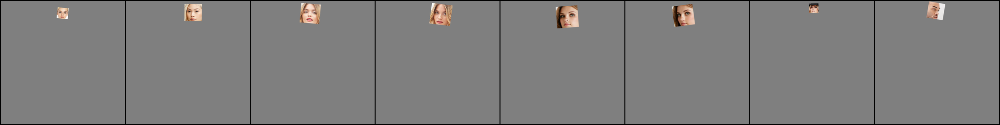

Discriminator input


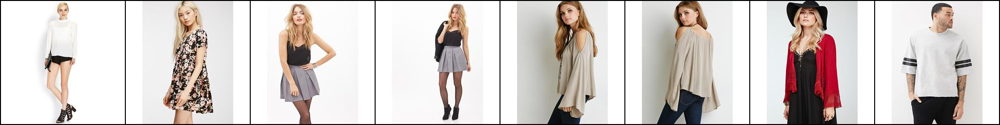

2775


In [11]:
# 原圖 + resample 過後的 mask（角度不一樣，大小和位置不同）
out7 = get_D_output(real_ds_pred, feed_G=False, D_input_mask_body=False)  # wrong

dataset size: 22202
data example


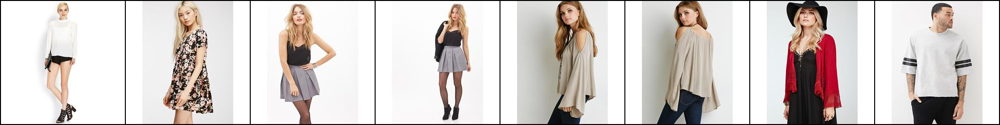

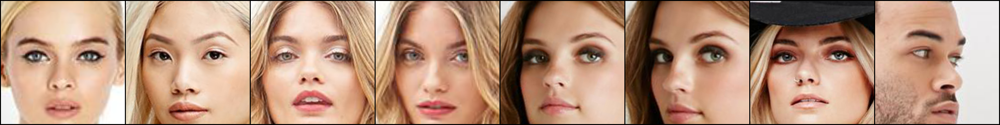

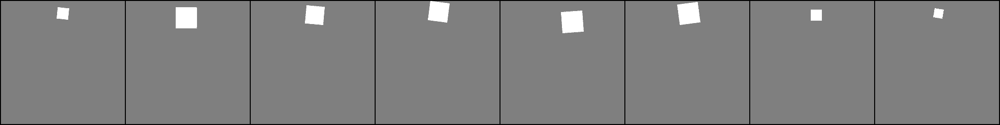

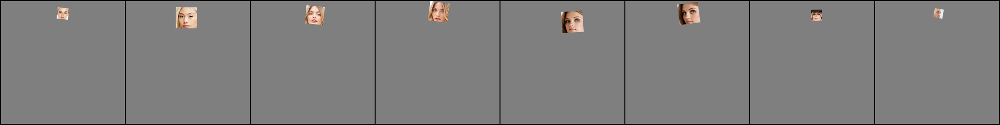

Discriminator input


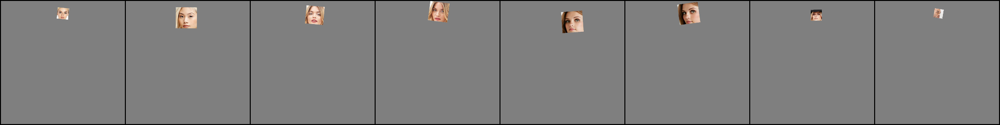

2775


In [19]:
out8 = get_D_output(real_ds_pred, feed_G=False, D_input_mask_body=True)

dataset size: 22202
data example


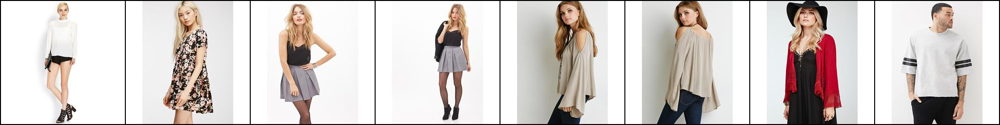

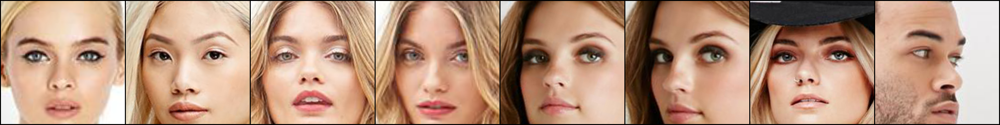

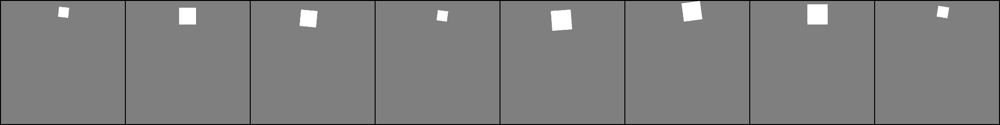

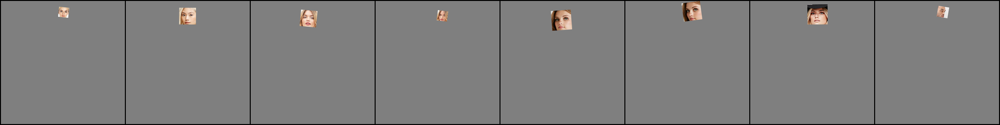

Generator Content input(RGB part)


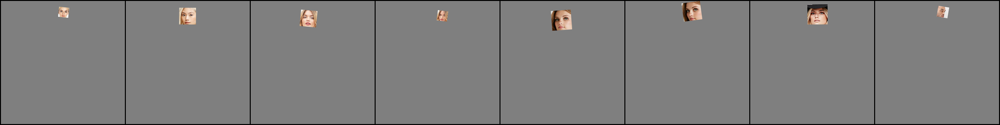

Discriminator input


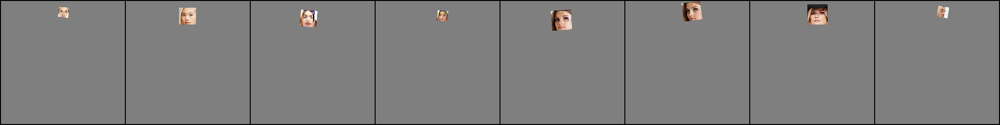

2775


In [37]:
out8_2 = get_D_output(real_ds_pred, feed_G=True, D_input_mask_body=True)

dataset size: 22202
data example


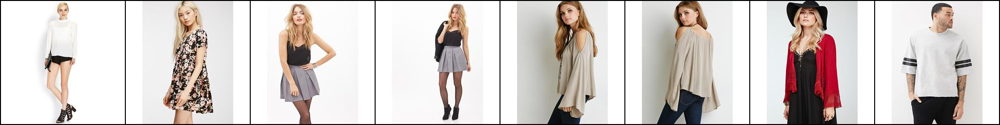

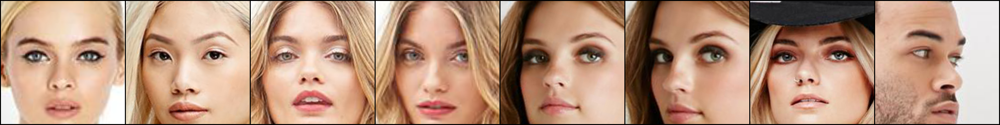

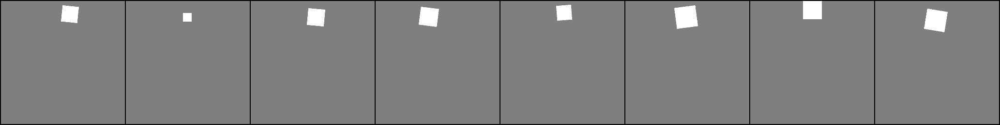

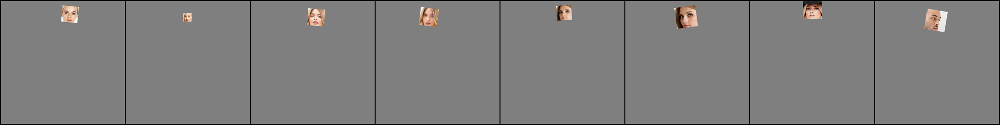

Generator Content input(RGB part)


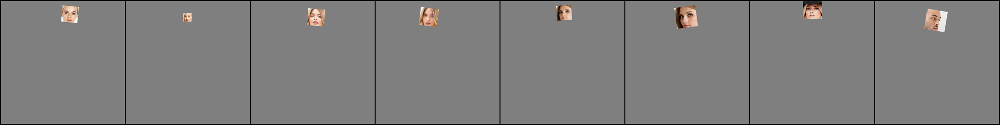

Discriminator input


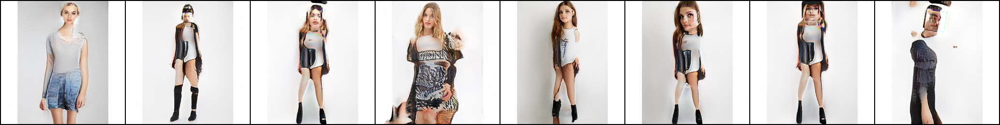

2775


In [13]:
out9 = get_D_output(real_ds_pred, feed_G=True, D_input_mask_body=False)

In [40]:
for i in [4, 5, '5_2', 6, 7, 8, '8_2', 9]:
    out = globals().get(f'out{i}')
    print(f"{i}\t: {out.mean(): .2f} {out.max(): .2f} {out.min(): .2f} {out.std(): .2f} {np.sign(out).sum() / out.size: .4f}")

4	: -7.50  5.41 -13.47  2.41 -0.9959
5	: -10.02 -2.04 -14.93  2.36 -1.0000
5_2	: -9.59 -1.87 -14.35  2.21 -1.0000
6	: -8.04 -0.91 -13.34  2.19 -1.0000
7	: -8.61  3.55 -13.56  2.05 -0.9991
8	: -11.21 -4.27 -15.05  1.95 -1.0000
8_2	: -10.62 -3.84 -14.27  1.78 -1.0000
9	: -9.09 -2.83 -13.54  1.85 -1.0000


In [17]:
for i, out in enumerate([out1, out2, out3]):
    print(f"{i}: {out.mean(): .2f} {out.max(): .2f} {out.min(): .2f} {out.std(): .2f} {np.sign(out).sum() / out.size: .4f}")

0:  2.87  5.40 -0.81  1.20  0.92
1: -1.14 -0.23 -3.00  0.19 -1.00
2: -0.60  3.86 -2.71  0.44 -0.92


In [5]:
import ipywidgets as widgets
from ipywidgets import interact, interactive, fixed, interact_manual
from IPython.display import display

In [5]:
@interact(p1=False, p2=False, p3=True)
def f(**kwargs):
    return kwargs

interactive(children=(Checkbox(value=False, description='p1'), Checkbox(value=False, description='p2'), Checkb…

In [9]:
a1 = widgets.Checkbox(description="feed Generator")
b1 = widgets.Checkbox(description="mask before D. in")
c1 = widgets.Dropdown(options=[('real', 0), ('resample-gt', 1), ('resample-pred', 2)], description="dataset")
ui1 = widgets.HBox([c1, a1, b1])

a2 = widgets.Checkbox(description="feed Generator")
b2 = widgets.Checkbox(description="mask before D. in")
c2 = widgets.Dropdown(options=[('real', 0), ('resample-gt', 1), ('resample-pred', 2)], description="dataset")
ui2 = widgets.HBox([c2, a2, b2])

def f(a, b, c):
    d = d_output[(int(a), int(b), int(c))]
    print(f"mean: {d.mean(): .4f}; max: {d.max(): .4f}; min: {d.min(): .4f}; std: {d.std(): .4f}")

out1 = widgets.interactive_output(f, {'a': a1, 'b': b1, 'c': c1})
out2 = widgets.interactive_output(f, {'a': a2, 'b': b2, 'c': c2})

In [12]:
d_output.keys()

dict_keys([(0, 0, 0), (0, 1, 0), (1, 0, 0), (0, 0, 1), (0, 1, 1), (1, 1, 1), (1, 0, 1), (0, 0, 2), (0, 1, 2), (1, 1, 2), (1, 0, 2)])

In [11]:
display(ui1, out1)
display(ui2, out2)

Output(outputs=({'name': 'stdout', 'text': 'mean:  2.8705; max:  5.4025; min: -0.8085; std:  1.1978\n', 'outpu…

Output(outputs=({'name': 'stdout', 'text': 'mean:  2.8705; max:  5.4025; min: -0.8085; std:  1.1978\n', 'outpu…

### Insights
* 1 v.s   2: 身體RGB部份還是要有，不然全部都會被 Discriminator 辨識為假的
* 1 v.s   3: 儘管用真實圖片作為條件輸入，大部分的圖(0.92)都還是被辨認為假的
* 1 v.s   4: 儘管 RGB 是真圖，mask 不對分數會差很多
* 5 v.s 5_2: masked_body 經過 Generator 分數反而好0.5 ?? (Reconstruction loss 沒有完全還原) (8 v.s 8_2 同理)
* 4 v.s   6: mask有對齊但是身體部份品質不好 比 mask沒對齊但是身體部份品質好 還差
* 6 v.s   9: 對真臉使用真的 phi 和其他模型預測的 phi 使分數掉了1分

In [39]:
pickle.dump(d_output, open('d_output.pkl', 'wb'))

In [38]:
d_output[(0,0,1)] = out4
d_output[(0,1,1)] = out5
d_output[(1,1,1)] = out5_2
d_output[(1,0,1)] = out6
d_output[(0,0,2)] = out7
d_output[(0,1,2)] = out8
d_output[(1,1,2)] = out8_2
d_output[(1,0,2)] = out9

In [33]:
d_output_new = {}
target_len = 3
for k, v in d_output.items():
    if len(k) < target_len:
        new_key = k + (0,) * (target_len - len(k))
        d_output_new[new_key] = v
d_output = d_output_new

In [10]:
# fake 
cfg2 = cfg.clone()
cfg2.DATASET.dataset = 'FakeDeepFashionFace'
ds_fake_train = get_dataset(cfg2.DATASET, split='train', num_items=5000)

fake_train_out = []
loader = torch.utils.data.DataLoader(ds_fake_train, batch_size=8, num_workers=10, worker_init_fn=ds_fake_train.__class__.worker_init_fn)
for i, batch in enumerate(loader):
    masked_body, face, mask = [x.cuda() for x in batch]
    masked_body = torch.cat([masked_body, mask], dim=1)
    
    noise = mixing_noise(8, g.z_dim, 0.9, 'cuda')
    fake_img, _ = g(noise, labels_in=None, style_in=face, content_in=masked_body)
    d_input = torch.cat([fake_img, masked_body[:, 3:, :, :]], dim=1)
    fake_train_out.append(d(d_input).detach().cpu().numpy())
    print(f"{i}", end='\r')

Setting up PyTorch plugin "upfirdn2d_plugin"... Done.


In [12]:
fake_train_out = np.concatenate(fake_train_out, axis=0)
print(fake_train_out.mean(), fake_train_out.max(), fake_train_out.min(), fake_train_out.std())

-9.307931 -2.8808317 -13.234204 1.8839545


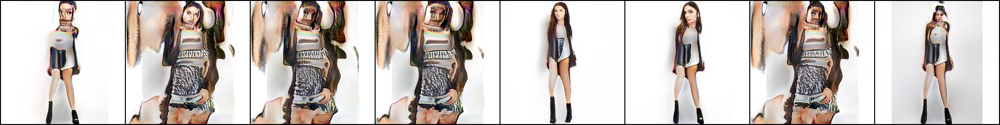

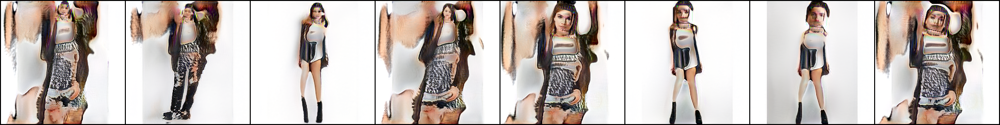

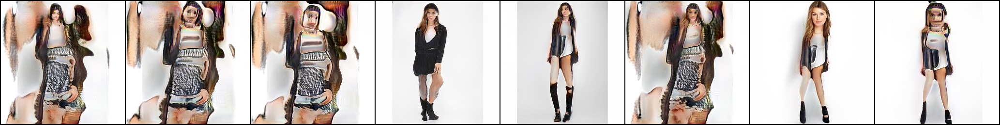

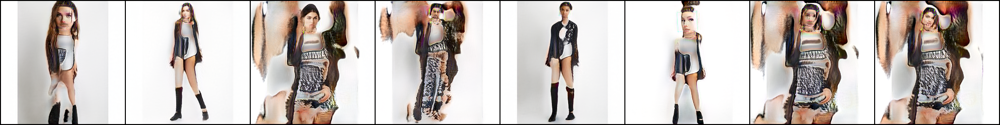

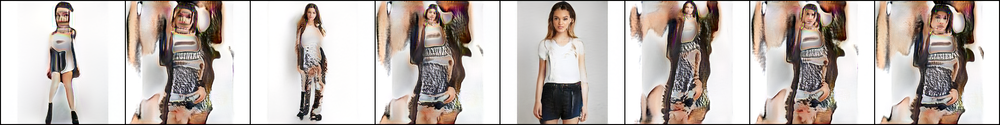

...

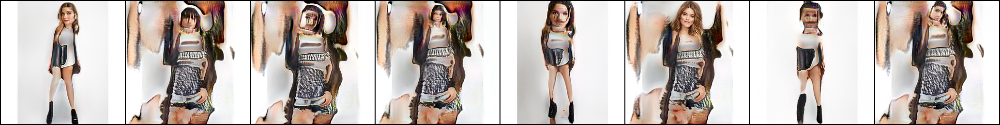

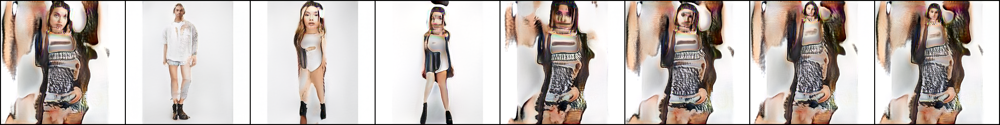

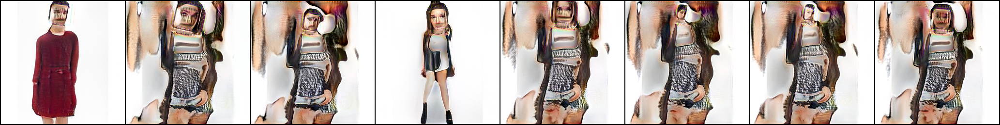

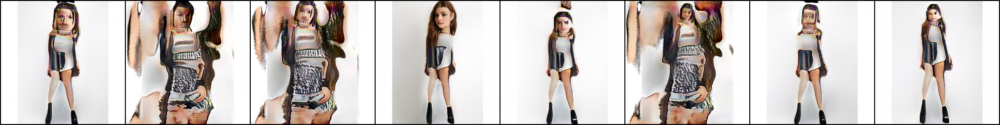

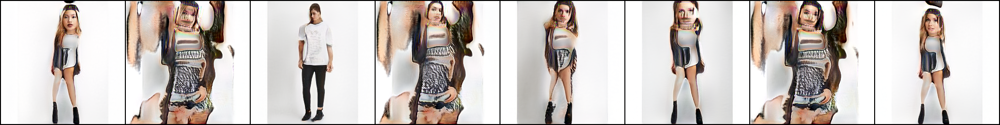

In [8]:
cfg2 = cfg.clone()
cfg2.DATASET.dataset = 'FakeDeepFashionFace'
ds_fake_train = get_dataset(cfg2.DATASET, split='train', num_items=96)

fake_train_out = []
loader = torch.utils.data.DataLoader(ds_fake_train, batch_size=8, num_workers=10, worker_init_fn=ds_fake_train.__class__.worker_init_fn)
for i, batch in enumerate(loader):
    masked_body, face, mask = [x.cuda() for x in batch]
    masked_body = torch.cat([masked_body, mask], dim=1)
    
    noise = mixing_noise(8, g.z_dim, 0.9, 'cuda')
    fake_img, _ = g(noise, labels_in=None, style_in=face, content_in=masked_body)
    show(fake_img)

In [6]:
# fake with real mask
cfg2 = cfg.clone()
cfg2.DATASET.dataset = 'FakeDeepFashionFace2'
ds_fake_train = get_dataset(cfg2.DATASET, split='train', num_items=5000)

fake_train_out = []
loader = torch.utils.data.DataLoader(ds_fake_train, batch_size=8, num_workers=10, worker_init_fn=ds_fake_train.__class__.worker_init_fn)
for i, batch in enumerate(loader):
    masked_body, face, mask = [x.cuda() for x in batch]
    masked_body = torch.cat([masked_body, mask], dim=1)
    
    noise = mixing_noise(8, g.z_dim, 0.9, 'cuda')
    fake_img, _ = g(noise, labels_in=None, style_in=face, content_in=masked_body)
    d_input = torch.cat([fake_img, masked_body[:, 3:, :, :]], dim=1)
    fake_train_out.append(d(d_input).detach().cpu().numpy())
    print(f"{i}", end='\r')
    
fake_train_out = np.concatenate(fake_train_out, axis=0)
print(fake_train_out.mean(), fake_train_out.max(), fake_train_out.min(), fake_train_out.std())

Setting up PyTorch plugin "upfirdn2d_plugin"... Done.
-7.25559 1.8620849 -12.758066 2.4124184


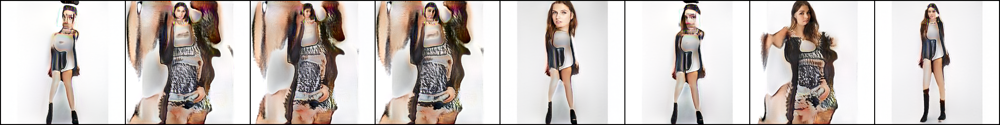

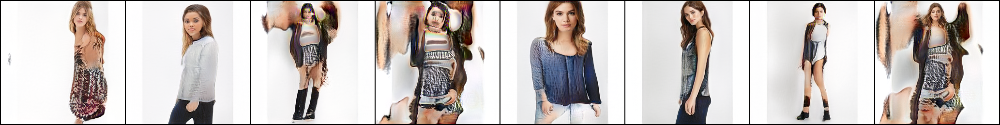

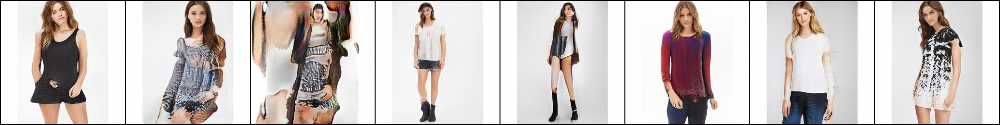

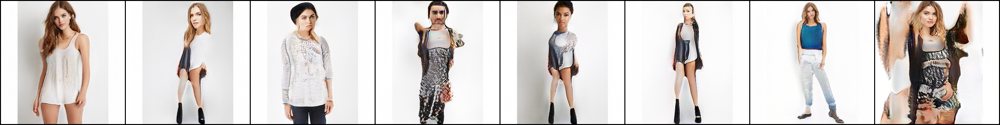

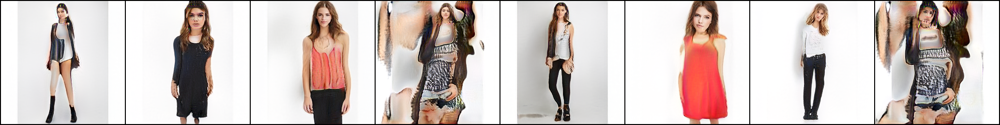

...

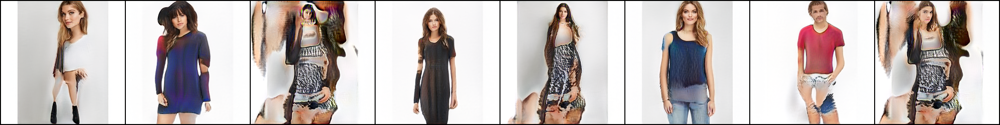

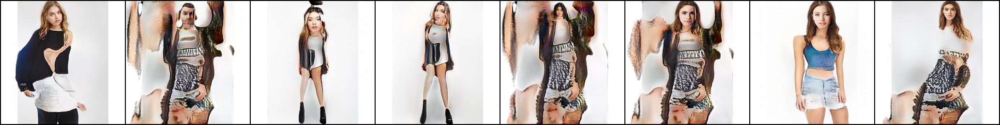

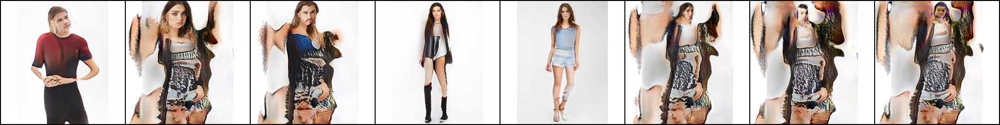

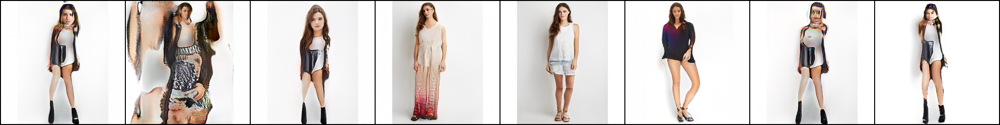

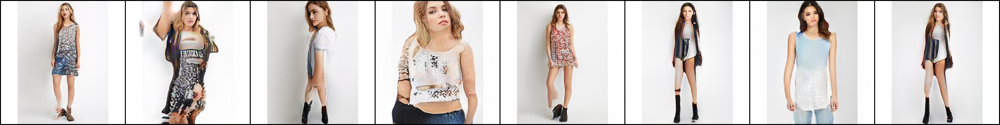

In [7]:
cfg2 = cfg.clone()
cfg2.DATASET.dataset = 'FakeDeepFashionFace2'
ds_fake_train = get_dataset(cfg2.DATASET, split='train', num_items=96)

fake_train_out = []
loader = torch.utils.data.DataLoader(ds_fake_train, batch_size=8, num_workers=10, worker_init_fn=ds_fake_train.__class__.worker_init_fn)
for i, batch in enumerate(loader):
    masked_body, face, mask = [x.cuda() for x in batch]
    masked_body = torch.cat([masked_body, mask], dim=1)
    
    noise = mixing_noise(8, g.z_dim, 0.9, 'cuda')
    fake_img, _ = g(noise, labels_in=None, style_in=face, content_in=masked_body)
    show(fake_img)

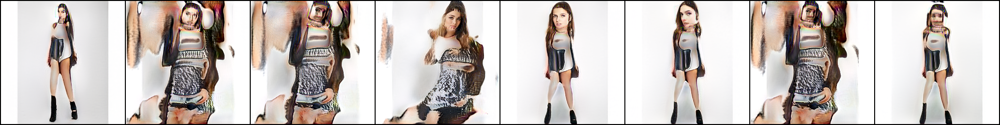

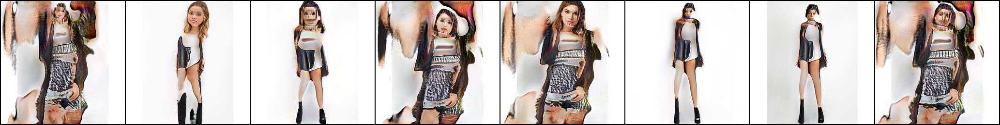

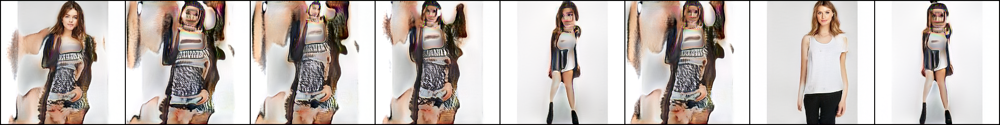

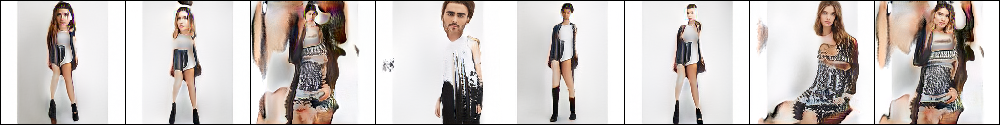

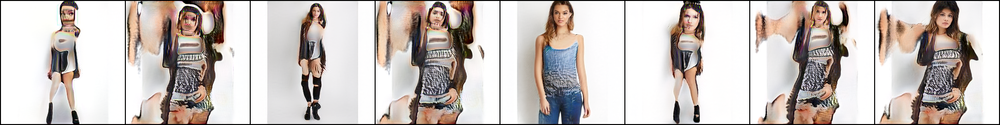

...

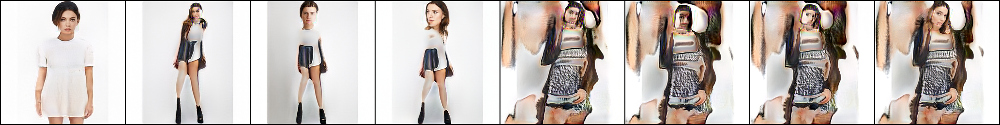

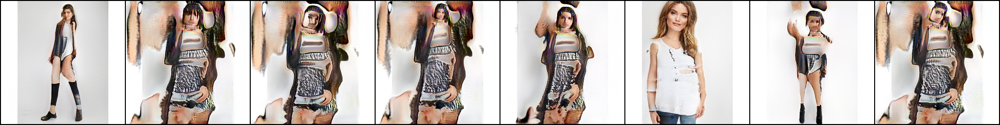

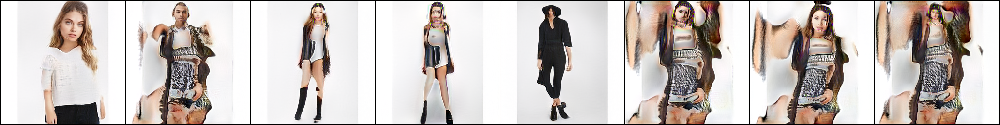

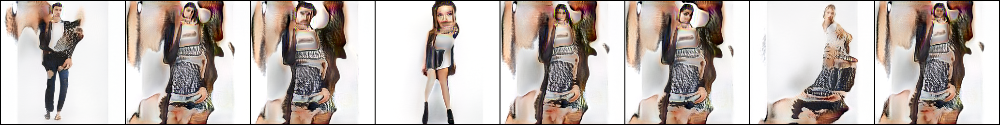

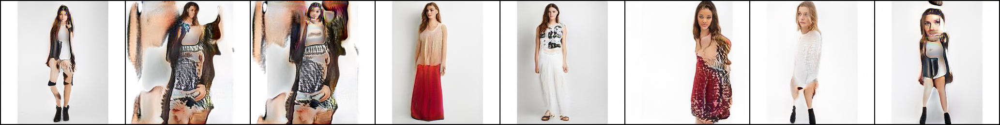

-8.328225 3.8366768 -13.145482 2.3173354


In [20]:
cfg2 = cfg.clone()
cfg2.DATASET.dataset = 'FakeDeepFashionFace3'
ds_fake_train = get_dataset(cfg2.DATASET, split='train', num_items=5000)

fake_train_out = []
loader = torch.utils.data.DataLoader(ds_fake_train, batch_size=8, num_workers=10, worker_init_fn=ds_fake_train.__class__.worker_init_fn)
for i, batch in enumerate(loader):
    masked_body, face, mask = [x.cuda() for x in batch]
    masked_body = torch.cat([masked_body, mask], dim=1)
    
    noise = mixing_noise(8, g.z_dim, 0.9, 'cuda')
    fake_img, _ = g(noise, labels_in=None, style_in=face, content_in=masked_body)
    if i <= 10:
        show(fake_img)
    d_input = torch.cat([fake_img, masked_body[:, 3:, :, :]], dim=1)
    fake_train_out.append(d(d_input).detach().cpu().numpy())
    print(f"{i}", end='\r')
    
fake_train_out = np.concatenate(fake_train_out, axis=0)
print(fake_train_out.mean(), fake_train_out.max(), fake_train_out.min(), fake_train_out.std())

In [6]:
interact(f, x=[('one', 10), ('two', 20)]);

interactive(children=(Dropdown(description='x', options=(('one', 10), ('two', 20)), value=10), Output()), _dom…

In [7]:
w = widgets.Checkbox(
    value=False,
    description='Check me',
    disabled=False,
    indent=False
)
display(w)

Checkbox(value=False, description='Check me', indent=False)

## Make ID -> quad mapping for Real dataset

In [14]:
l = json.load(open('/home/yct/data/deepfashion/df_landmarks.json', 'r'))

In [15]:
def get_quad(lm):
    lm = np.array(item['in_the_wild']['face_landmarks'])
    lm_chin          = lm[0  : 17]  # left-right
    lm_eyebrow_left  = lm[17 : 22]  # left-right
    lm_eyebrow_right = lm[22 : 27]  # left-right
    lm_nose          = lm[27 : 31]  # top-down
    lm_nostrils      = lm[31 : 36]  # top-down
    lm_eye_left      = lm[36 : 42]  # left-clockwise
    lm_eye_right     = lm[42 : 48]  # left-clockwise
    lm_mouth_outer   = lm[48 : 60]  # left-clockwise
    lm_mouth_inner   = lm[60 : 68]  # left-clockwise

    # Calculate auxiliary vectors.
    eye_left     = np.mean(lm_eye_left, axis=0)
    eye_right    = np.mean(lm_eye_right, axis=0)
    eye_avg      = (eye_left + eye_right) * 0.5
    eye_to_eye   = eye_right - eye_left
    mouth_left   = lm_mouth_outer[0]
    mouth_right  = lm_mouth_outer[6]
    mouth_avg    = (mouth_left + mouth_right) * 0.5
    eye_to_mouth = mouth_avg - eye_avg

    # Choose oriented crop rectangle.
    x = eye_to_eye - np.flipud(eye_to_mouth) * [-1, 1]
    x /= np.hypot(*x)
    x *= max(np.hypot(*eye_to_eye) * 1.2, np.hypot(*eye_to_mouth) * 1.2 * 0.9)
    y = np.flipud(x) * [-1, 1]
    c = eye_avg + eye_to_mouth * 0.1
    quad = np.stack([c - x - y, c - x + y, c + x + y, c + x - y])
    return quad

In [16]:
quads = {}  # fileID: quad
for item in l.values():
    lm = np.array(item['in_the_wild']['face_landmarks'])
    fileID = item['in_the_wild']['file_path'].split('/')[1].split('.')[0]
    quads[fileID] = get_quad(lm)
pickle.dump(quads, open('/home/yct/data/deepfashion/align_1.2/ID2quad.pkl', 'wb'))